# Does Sky Background subtraction CTIO Data in January 2017
==================================================================================================

- author : Sylvie Dagoret-Campagne
- date   : January 18th 2017
- update : January 24th 2017

### This notebook should sbtract more sky background to the images
-----------------------------------------------------------------------
- If sky background is subtracted, we only have the star spectrum
- This work must be proven usefull

### Please execute the javascript below by hand

In [3]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [4]:
print theNotebook

SkyBGSubt_HD14943


In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os

In [6]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [7]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal

In [8]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.0.0


In [9]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [10]:
from IPython.display import Image, display

In [11]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [12]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (8, 8),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [13]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

### Output directory for images generated in the notebook view (not true fits images)

In [14]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [15]:
ensure_dir(dir_top_images) # create that directory

### Output Fits images

In [16]:
outputdir="processed_fitsimages"
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [17]:
rootpath_rawimage="./reduced_fitsimages"
object_name='HD60753'

In [18]:
#dirlist_all=os.listdir(rootpath_rawimage) 

In [19]:
#if '.DS_Store' in dirlist_all:
#    dirlist_all.remove('.DS_Store')
dirlist=[]
dirlist.append(rootpath_rawimage)
dirlist_all=np.array(dirlist)

In [20]:
print dirlist_all

['./reduced_fitsimages']


In [21]:
!ls ./reduced_fitsimages

README.md                         reduced_HD14943_20170117_144.fits
reduced_HD14943_20170117_092.fits reduced_HD14943_20170117_145.fits
reduced_HD14943_20170117_093.fits reduced_HD14943_20170117_146.fits
reduced_HD14943_20170117_094.fits reduced_HD14943_20170117_147.fits
reduced_HD14943_20170117_095.fits reduced_HD14943_20170117_148.fits
reduced_HD14943_20170117_096.fits reduced_HD14943_20170117_149.fits
reduced_HD14943_20170117_097.fits reduced_HD14943_20170117_150.fits
reduced_HD14943_20170117_098.fits reduced_HD14943_20170117_151.fits
reduced_HD14943_20170117_099.fits reduced_HD14943_20170117_152.fits
reduced_HD14943_20170117_100.fits reduced_HD14943_20170117_153.fits
reduced_HD14943_20170117_101.fits reduced_HD14943_20170117_154.fits
reduced_HD14943_20170117_102.fits reduced_HD14943_20170117_155.fits
reduced_HD14943_20170117_103.fits reduced_HD14943_20170117_156.fits
reduced_HD14943_20170117_104.fits reduced_HD14943_20170117_157.fits
reduced_HD14943_20170117_105.fits reduced_HD1494

In [22]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [23]:
def MakeFileList():
    """
    MakeFileList : Make The List of files to open
    =============
    """
    count=0
    
    for dir in dirlist_all: # loop on directories, one per image       
            dir_leaf= dir # build the name of leaf directory
            listfiles=os.listdir(dir_leaf) 
            for filename in listfiles:
                if re.search('^reduced_HD60753_20170117_([0-9]+).fits$',filename):  #example of filename filter
                    str_index=re.findall('^reduced_HD60753_20170117_([0-9]+).fits$',filename)
                    count=count+1
                    index=int(str_index[0])
                    indexes_files.append(index)         
                    shortfilename=dir_leaf+'/'+filename
                    filelist_fitsimages.append(shortfilename)
                    
    return

In [24]:
MakeFileList()   # Make the list

In [25]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [26]:
print len(indexes_files)

104


In [27]:
print len(filelist_fitsimages)

104


In [28]:
print indexes_files

[ 92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195]


In [29]:
len(indexes_files)

104

In [30]:
filelist_fitsimages

array(['./reduced_fitsimages/reduced_HD14943_20170117_092.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_093.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_094.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_095.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_096.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_097.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_098.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_099.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_100.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_101.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_102.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_103.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_104.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_105.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_106.fits',
       './reduced_fitsima

In [31]:
len(filelist_fitsimages)

104

In [32]:
#sorted_dates=np.argsort(filelist_fitsimages)

In [33]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [34]:
sorted_indexes

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103])

In [35]:
#print sorted_dates

In [36]:
print sorted_indexes

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103]


In [37]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [38]:
#sorted_numbers= [indexes_files[index] for index in sorted_indexes]
sorted_numbers=indexes_files[sorted_indexes]

In [39]:
sorted_numbers

array([ 92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
       131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
       144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
       157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
       170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182,
       183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195])

In [40]:
sorted_files

array(['./reduced_fitsimages/reduced_HD14943_20170117_092.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_093.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_094.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_095.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_096.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_097.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_098.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_099.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_100.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_101.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_102.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_103.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_104.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_105.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_106.fits',
       './reduced_fitsima

## Build full filename
----------------------------

In [41]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(rootpath_rawimage,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [42]:
sorted_filenames=np.array(sorted_filenames)

In [43]:
sorted_filenames

array(['./reduced_fitsimages/reduced_HD14943_20170117_092.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_093.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_094.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_095.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_096.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_097.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_098.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_099.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_100.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_101.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_102.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_103.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_104.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_105.fits',
       './reduced_fitsimages/reduced_HD14943_20170117_106.fits',
       './reduced_fitsima

## Acces to data of  images
----------------------------------

In [44]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []

In [45]:
def BuildRawImages():
    """
    BuildRawImages
    ===============
    """

    global all_dates
    global all_airmass
    global all_images
    global all_titles
    global all_header
    global all_img 
    global sorted_filenames

    for idx,file in np.ndenumerate(sorted_filenames):   
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        num=sorted_numbers[idx[0]]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        hdu_list.close()

In [46]:
BuildRawImages()

## Show images
-----------------------

In [47]:
def ShowRawImages():
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    global all_images
    global all_titles
    global object_name

    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1

    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_images[index],vmin=-10,vmax=100)
        axarr[iy,ix].set_title(all_titles[index])
    title='Raw images of '.format(object_name)
    plt.suptitle(title,size=16) 
    figfilename=os.path.join(dir_top_images,'viewrredimages.pdf')
    plt.savefig(figfilename)                             

In [48]:
# ShowRawImages() : to spare notebook file size for github

## Show histograms
===========================

In [49]:
def ShowHistograms():
    """
    ShowHistograms
    ==============
    """
    global all_images
    global all_titles
    global object_name


    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        image_flat=all_images[index].flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=100,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo of images '.format(object_name)
    plt.suptitle(title,size=16)  
    figfilename=os.path.join(dir_top_images,'viewrhistoredimages.pdf')
    plt.savefig(figfilename)   

In [50]:
# ShowHistograms() #to spare notebook file size for github

## Transfer the image in CCDData
====================================

In [51]:
NBIMAGES=len(all_images)
all_ccd = []
for index in np.arange(0,NBIMAGES):
    ccd=ccdproc.CCDData(all_images[index],unit='adu')
    all_ccd.append(ccd)

## Extraction of Background
===============================

In [52]:
sigma_clip = SigmaClip(sigma=3., iters=10)

In [53]:
bkg_estimator = MedianBackground()

In [54]:
all_bkg = []  # container for all background

In [55]:
def ComputeBackground():
    """
    ComputeBackground
    ==================
    
    """
    global all_bkg
    global sigma_clip
    global bkg_estimator
    global all_ccd
    

    NBIMAGES=len(all_ccd)

    for index in np.arange(0,NBIMAGES):
        print 'compute background for image nb. ',index,' ',all_titles[index]
        bkg = Background2D(all_ccd[index], (100, 100), filter_size=(3, 3),method='median')
        #bkg = Background2D(ccd.data, (50, 50), filter_size=(3, 3),sigma_clip=sigma_clip,bkg_estimator=bkg_estimator)
        all_bkg.append(bkg)

In [56]:
ComputeBackground()

compute background for image nb.  0   HD14943 z= 1.25 Nb=92
compute background for image nb.  1   HD14943 z= 1.31 Nb=93
compute background for image nb.  2   HD14943 z= 1.31 Nb=94
compute background for image nb.  3   HD14943 z= 1.31 Nb=95
compute background for image nb.  4   HD14943 z= 1.32 Nb=96
compute background for image nb.  5   HD14943 z= 1.32 Nb=97
compute background for image nb.  6   HD14943 z= 1.32 Nb=98
compute background for image nb.  7   HD14943 z= 1.33 Nb=99
compute background for image nb.  8   HD14943 z= 1.33 Nb=100
compute background for image nb.  9   HD14943 z= 1.34 Nb=101
compute background for image nb.  10   HD14943 z= 1.34 Nb=102
compute background for image nb.  11   HD14943 z= 1.34 Nb=103
compute background for image nb.  12   HD14943 z= 1.35 Nb=104
compute background for image nb.  13   HD14943 z= 1.35 Nb=105
compute background for image nb.  14   HD14943 z= 1.37 Nb=106
compute background for image nb.  15   HD14943 z= 1.37 Nb=107
compute background for ima

## Plot Background
=========================

In [57]:
def PlotBackground():
    """
    PlotBackground
    ===============
    """
    
    global all_bkg
    global all_title
    global object_name
    
    NBBKG=len(all_bkg)
    MAXIMGROW=int(NBBKG/5)+1
      
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBBKG):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_bkg[index].background,vmin=0,vmax=60)
        axarr[iy,ix].set_title(all_titles[index])
    title='PhotUtils Background for image {}'.format(object_name)

    #f.colorbar(im, ax=axarr.ravel().tolist(),shrink=0.75)
    f.colorbar(im)
    plt.suptitle(title,size=16) 
    figfilename=os.path.join(dir_top_images,'viewskybackgroundimages.pdf')
    plt.savefig(figfilename)   

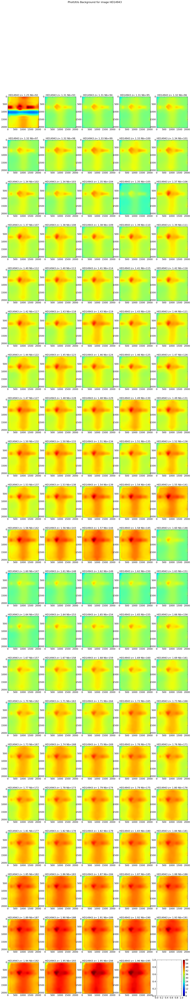

In [58]:
PlotBackground() # to spare file size on GitHub

## Do the background subtraction again
======================================================

In [59]:
NBIMAGES=len(all_ccd)
all_ccd_bgsub = []
for index in np.arange(0,NBIMAGES):
    ccd_bgsub=all_ccd[index] - all_bkg[index].background    
    all_ccd_bgsub.append(ccd_bgsub)

In [60]:
def PlotImagesWithBGSubtraction():
    """
    """
    global all_ccd_bgsub
    global all_title
    global object_name
    
    
    NBIMG=len(all_ccd_bgsub)
    MAXIMGROW=int(NBIMG/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMG):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_ccd_bgsub[index],vmin=-50,vmax=50)
        axarr[iy,ix].set_title(all_titles[index])
    title='Image with Background subtrated {}'.format(object_name)
    f.colorbar(im, ax=axarr.ravel().tolist(),shrink=0.75)
    plt.suptitle(title,size=16) 
    figfilename=os.path.join(dir_top_images,'viewskybgsubtimages.pdf')
    plt.savefig(figfilename)   

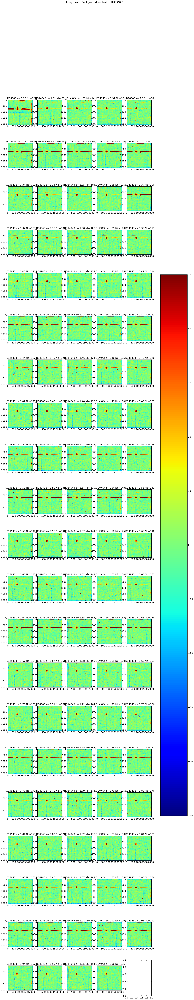

In [61]:
PlotImagesWithBGSubtraction()

In [62]:
def PlotHistoWithBGSubtraction():
    """
    """
    
    global all_ccd_bgsub
    global all_title
    global object_name
    
    NBIMG=len(all_ccd_bgsub)
    MAXIMGROW=int(NBIMG/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMG):
        ix=index%5
        iy=index/5
        image_flat=all_ccd_bgsub[index].flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=120,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo images bg subtraction {}'.format(object_name)
    plt.suptitle(title,size=16) 
    figfilename=os.path.join(dir_top_images,'histoskybgsubtimages.pdf')
    plt.savefig(figfilename) 

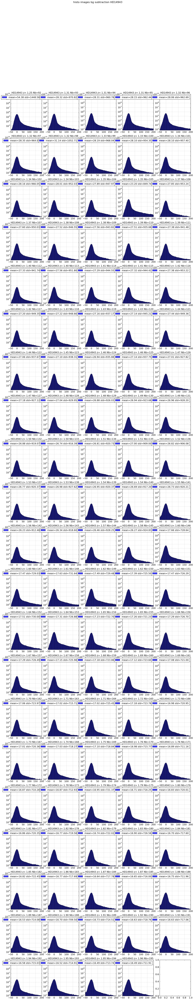

In [63]:
PlotHistoWithBGSubtraction()

## Save the files with background subtraction
----------------------------------------------------------

In [64]:
sorted_newfiles=[]
for idx,file in np.ndenumerate(sorted_files):
    extracted=re.findall('./reduced_fitsimages/reduced_(.+)', file)
    rootfilename=extracted[0]
    newfilename='imgbkgsub_'+rootfilename
    newfullfilename=os.path.join(outputdir,newfilename)
    sorted_newfiles.append(newfullfilename)

In [65]:
for idx,file in np.ndenumerate(sorted_newfiles):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=all_ccd_bgsub[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,clobber=True)